In [1]:
import numpy as np
from pyscf import gto, scf
import matplotlib.pyplot as plt
import copy
import itertools

# Utilities
from slowquant.molecularintegrals.integralfunctions import one_electron_integral_transform, two_electron_integral_transform
from slowquant.unitary_coupled_cluster.util import iterate_t1, iterate_t2

# Operators
from slowquant.unitary_coupled_cluster.operators import G1, G2
from slowquant.unitary_coupled_cluster.operators import hamiltonian_0i_0a
from slowquant.unitary_coupled_cluster.operator_state_algebra import propagate_state, expectation_value, construct_ups_state

# Wave function ansatz - unitary product state
from slowquant.unitary_coupled_cluster.ups_wavefunction import WaveFunctionUPS

<h2> Molecule object + integrals - pySCF

In [2]:
# Define water molecule within pySCF

# geometry = 'H 0.000000 0.000000 0.000000; H 0.740000 0.00000 0.000000' #H2 equilibrium
# geometry = 'H 0.000000 0.000000 0.000000; Li 1.595000 0.00000 0.000000' #LiH equilibrium
geometry = 'O 0.000000 0.000000 0.000000; H 0.960000 0.000000 0.000000; H -0.240365 0.929422 0.000000' #H2O equilibrium

mol_obj = gto.Mole()
mol_obj.build(atom = geometry, basis = 'sto-3g')
hf_obj = scf.RHF(mol_obj)
hf_obj.kernel()

converged SCF energy = -74.9633190700914


np.float64(-74.96331907009136)

In [3]:
nMO = 4
nEL = 4

cas_obj = hf_obj.CASCI(nMO, nEL)
cas_obj.conv_tol = 1e-14
cas_obj.max_cycle_macro = 100
cas_obj.kernel()

print(f'Energy HF: {hf_obj.energy_tot()-mol_obj.enuc}, Energy CAS: {cas_obj.e_tot-mol_obj.enuc}')

CASCI E = -74.9708096848979  E(CI) = -6.15859337781737  S^2 = 0.0000000
Energy HF: -84.13151089283818, Energy CAS: -84.13900150764476


<class 'pyscf.mcscf.casci.CASCI'> does not have attributes  max_cycle_macro conv_tol


In [4]:
# Getting integrals in MO basis

h_ao = mol_obj.intor('int1e_kin')+mol_obj.intor('int1e_nuc')
g_ao = mol_obj.intor('int2e')
mo_coeff = hf_obj.mo_coeff

h_mo = one_electron_integral_transform(mo_coeff,h_ao)
g_mo = two_electron_integral_transform(mo_coeff,g_ao)

<h1> Adapt from Anurag

In [5]:
def do_adapt(WF, maxiter=1000, epoch=1e-6 , orbital_opt: bool = False):
    '''Run Adapt VQE algorithm
    
    args:
        maxiter: max number of VQE iteration
        epoch: gradient variation threshold
        orbital_opt: enable orbital optimization
    '''

    #DEFINE EXCITATION POOL: tuples contain indeces of occupied and unoccupied SOs characterizing excitations
    excitation_pool: list[tuple[int, ...]] = [] 
    excitation_pool_type: list[str] = []

    #Generate indeces for singly-excited operators
    for a, i in iterate_t1(WF.active_occ_spin_idx, WF.active_unocc_spin_idx):
    #for a, i in iterate_t1_sa(self.active_occ_spin_idx, self.active_unocc_spin_idx):
        excitation_pool.append((int(a),int(i)))            
        excitation_pool_type.append("single")

    #Generate indeces for doubly-excited operators
    for a, i, b, j in iterate_t2(WF.active_occ_spin_idx, WF.active_unocc_spin_idx):
        excitation_pool.append((i, j, a, b))
        excitation_pool_type.append("double")
    #print(self.ups_layout.excitation_indices)
    #print(self.ups_layout.excitation_operator_type)
    
    nloop = 0

    # ADAPT ANSATZ + VQE
    for j in range(maxiter):

        #Energy Hamiltonian Fermionic operator
        Hamiltonian = hamiltonian_0i_0a(
            WF.h_mo,
            WF.g_mo,
            WF.num_inactive_orbs,
            WF.num_active_orbs,
        )

        #Apply operator to state -> obtain new state (list of operators, state, info on CI space, active space params)
        H_ket = propagate_state([Hamiltonian], WF.ci_coeffs, WF.ci_info, WF.thetas, WF.ups_layout)

        grad = []
        
        #GRADIENTS
        for i in range(len(excitation_pool_type)):

            #Looping through operators in the pool -> calculate gradient on the fly
            if excitation_pool_type[i] == "single":
                (i, a) = np.array(excitation_pool[i]) 
                T = G1(i, a, True)
            elif excitation_pool_type[i] == "double":
                (i, j, a, b) = np.array(excitation_pool[i]) 
                T = G2(i, j, a, b, True)
            else:
                raise ValueError(f"Got unknown excitation type {excitation_pool[i]}")
            
            #Calculate gradient, i.e. commutator -> expectation value function input (bra, operator, ket (here Hket))
            gr = expectation_value(WF.ci_coeffs, [T], H_ket,
                                WF.ci_info, WF.thetas, WF.ups_layout)
            gr -= expectation_value(H_ket, [T], WF.ci_coeffs,
                                WF.ci_info, WF.thetas, WF.ups_layout)
            grad.append(gr)
            
        print()
        print("------GP Printing Grad and Excitation Pool")
        print("------GP #################################")
        print(
                f"------GP{str("").center(72)}"
            )
        print(
                f"------GP{str("-----------------------------------------------------------------------------------").center(72)}"
            )
        print(
                f"------GP{str("Grad").center(27)} | {str("Excitation Pool indices").center(18)} | {str("Excitation Pool type").center(27)}"
            )
        for i in range(len(grad)):
            
            print(
                f"------GP{str(grad[i]).center(27)} | {str(excitation_pool[i]).center(18)} | {excitation_pool_type[i].center(27)}"
            )

        print()
        print("### Index of Max grad :: ", end=" ")
        print(np.argmax(np.abs(grad)))
        print("### Number of excitation gradient > %e :: "%(epoch), end=" ")
        print( (np.abs(grad) > epoch).sum())

        #Getting maximum gradient
        max_arg = np.argmax(np.abs(grad))

        #Check if gradient is smaller than smallest improvement (epoch)
        if(np.max(np.abs(grad)) < epoch):
            nloop = j
            break

        #Update ansatz with new excitation operator (corresponding to max gradient)
        WF.ups_layout.excitation_indices.append(np.array(excitation_pool[max_arg])-WF.num_inactive_spin_orbs) # rescale indeces to stay only in active space (?)
        WF.ups_layout.excitation_operator_type.append(excitation_pool_type[max_arg])
        #del excitation_pool[max_arg]
        #del excitation_pool_type[max_arg]
        WF.ups_layout.n_params += 1

        # reset excitation pool (always the same)
        excitation_pool = excitation_pool 
        excitation_pool_type = excitation_pool_type
        
        # add theta parameter for new operator
        WF._thetas.append(0.0)
        # np.append(WF._thetas, 0.0)

        # VQE optimization
        WF.run_wf_optimization_1step("bfgs", orbital_optimization=orbital_opt)
        print('#########CI COEFFS########')
        print(WF.ci_coeffs)
        print('#########################')

        print()
        print("------TP Printing the Optimised Theta")
        print("------TP ############################")
        
        print(
                f"------TP {str("Thetas").center(27)} | {str("UPS Layout indices").center(18)} | {str("Excitation indices").center(18)} | {str("UPS Layout type").center(27)}"
            )
        # for i in range(len(self._thetas)):
            
            # print(
                # f"------TP {str(self._thetas[i]).center(27)} | {str(self.ups_layout.excitation_indices[i]).center(18)} |{str(self.ups_layout.excitation_indices[i] + self.num_inactive_spin_orbs ).center(18)} | {self.ups_layout.excitation_operator_type[i].center(27)}"
            # )
    print("------TP  Number of Loop", end = " ")
    print(nloop)

    return WF

In [6]:
# newWF = do_adapt(WF, maxiter=3)

<h2> Rotoselect

In [7]:
# Define WaveFunction via SlowQuant
WF = WaveFunctionUPS(
        hf_obj.mol.nelectron,
        (4, 4),
        hf_obj.mo_coeff,
        h_ao,
        g_ao,
        "adapt",
        include_active_kappa=True,
    )

# Define Hamiltonian
H = hamiltonian_0i_0a(
    WF.h_mo,
    WF.g_mo,
    WF.num_inactive_orbs,
    WF.num_active_orbs
)

# Get the folded version (active orbitals only + effect of inactive folded in -> ASK ERIK!!) 
H_f = H.get_folded_operator(WF.num_inactive_orbs, WF.num_active_orbs, WF.num_virtual_orbs)


In [8]:
# DEFINE EXCITATION POOL 1: tuples contain indeces of occupied and unoccupied SOs characterizing excitations

pool_data = {
    "excitation indeces": [],
    "excitation type": [],
    "excitation operator": []
}

num_inactive_so = WF.num_inactive_spin_orbs # use it to rescale operator indeces to the active space

#Generate indeces for singly-excited operators
for a, i in iterate_t1(WF.active_occ_spin_idx, WF.active_unocc_spin_idx):
    pool_data["excitation indeces"].append((i, a))            
    pool_data["excitation type"].append("single")
    pool_data["excitation operator"].append(G1(i, a, True))

#Generate indeces for doubly-excited operators
for a, i, b, j in iterate_t2(WF.active_occ_spin_idx, WF.active_unocc_spin_idx):
    pool_data["excitation indeces"].append((i, j, a, b))
    pool_data["excitation type"].append("double")
    pool_data["excitation operator"].append(G2(i, j, a, b, True))

In [9]:
from rotoadapt_utils import pool_parallel, measurement_parallel_opt, optimizer

excitation_pool = pool_data["excitation indeces"]
excitation_pool_type = pool_data["excitation type"]

In [10]:
# ADAPT - basic implementation -> efficiency gains, convergence checks

# getting energy with zero layers
E_prev_adapt = float(expectation_value(WF.ci_coeffs, [H], WF.ci_coeffs, WF.ci_info, WF.thetas, WF.ups_layout))
en_traj = [E_prev_adapt]

converged = False

# while converged == False:
for layer in range(2):

    # Pool parsing

    results = pool_parallel(WF, H, pool_data)
    theta_pool, energy_pool = zip(*results)

    op_index = np.argmin(energy_pool)
    print('OPERATOR->', op_index)
    print(f'Theta {theta_pool[op_index]} - Energy {energy_pool[op_index]} - previous {E_prev_adapt}')

    deltaE_adapt = np.abs(energy_pool[op_index]-E_prev_adapt)

    if deltaE_adapt <= 1e-6:
        # converged = True
        break

    # Updating WF with new operator

    WF.ups_layout.excitation_indices.append(np.array(excitation_pool[op_index])-WF.num_inactive_spin_orbs)
    WF.ups_layout.excitation_operator_type.append(excitation_pool_type[op_index])
    WF.ups_layout.n_params += 1
    WF._thetas.append(theta_pool[op_index])
    WF.ci_coeffs = construct_ups_state(WF.ci_coeffs, WF.ci_info, WF.thetas, WF.ups_layout)

    # Reoptimizing all parameters

    if WF.ups_layout.n_params == 1:
        E_min = energy_pool[op_index]
        deltaE_adapt = np.abs(E_prev_adapt-E_min)

    else:

        for epochs in range(20):

            for d in range(WF.ups_layout.n_params):

                current_thetas = WF.thetas

                if epochs == 0:
                    energies = [energy_pool[op_index]]
                    thetas = [theta_pool[op_index]]
                    E_prev_opt = energy_pool[op_index]

                trial_thetas, trial_energies = measurement_parallel_opt(WF, H, d)

                Thetas = np.array(thetas + trial_thetas)
                Energies = np.array(energies + trial_energies)

                theta_min, E_min = optimizer(Thetas, Energies)

                current_thetas[d] = theta_min
                WF.thetas = current_thetas
                energies = [E_min]
                thetas = [theta_min]

            deltaE_opt = np.abs(E_prev_opt-E_min)
            print(f'Convergence at step {epochs}:', deltaE_opt)

            if deltaE_opt <= 5e-5:
                break

    deltaE_adapt = np.abs(E_min-E_prev_adapt)

    if deltaE_adapt <= 1e-6:
        print(f'FINAL RESULT - Energy: {energy_pool[op_index]} - Previous: {E_prev_adapt} - Delta: {deltaE_adapt} - Theta: {theta_pool[op_index]}')
        en_traj.append(E_min)
        # converged = True
        break

    else:
        en_traj.append(E_min)

1 399
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1.]
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1.]
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1.]
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1.]
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1.]
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1.]
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1.]
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1.]
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.

In [11]:
print(en_traj)
print(WF.ups_layout.excitation_operator_type)
print(WF.ups_layout.excitation_indices)

[-8.857341498221151, np.float64(-8.858167277486785), np.float64(-8.85836197588628)]
['double', 'double']
[array([2, 3, 6, 7]), array([2, 3, 4, 5])]


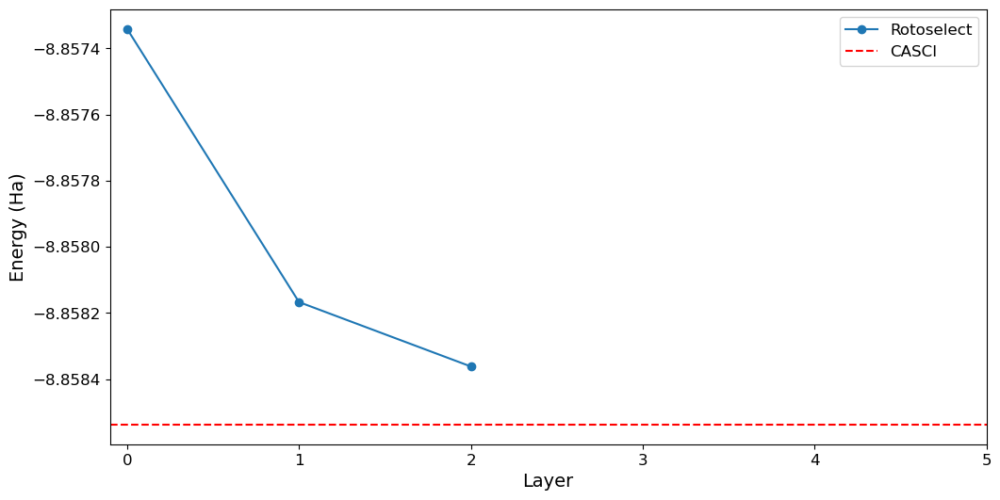

In [12]:
fig = plt.figure(figsize=(12,6))
plt.plot(en_traj, marker='o', label='Rotoselect')
plt.axhline(y=cas_obj.e_tot-mol_obj.enuc, color='red', ls='dashed', label='CASCI')

plt.xlabel('Layer', fontsize=14)
plt.ylabel('Energy (Ha)', fontsize=14)

plt.xticks(np.arange(0, 6), fontsize=12)
plt.yticks(fontsize=12)

plt.legend(fontsize=12)



In [130]:
test_traj = []
test_traj_an = []

for angle in np.linspace(0, 2*np.pi, 100):

    WF.thetas = [angle]
    test_traj.append(float(expectation_value(WF.ci_coeffs, [H], WF.ci_coeffs, WF.ci_info, WF.thetas, WF.ups_layout)))
    print('---', WF.ci_coeffs, float(expectation_value(WF.ci_coeffs, [H], WF.ci_coeffs, WF.ci_info, WF.thetas, WF.ups_layout)))

    test_traj_an.append(energy_landscape(A, B, C, D, E, angle))

1 399
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1.]
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1.]
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1.]
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1.]
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1.]
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1.]
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1.]
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1.]
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.

-84.1343862859938 3.1098593944626236 -84.13151089283818


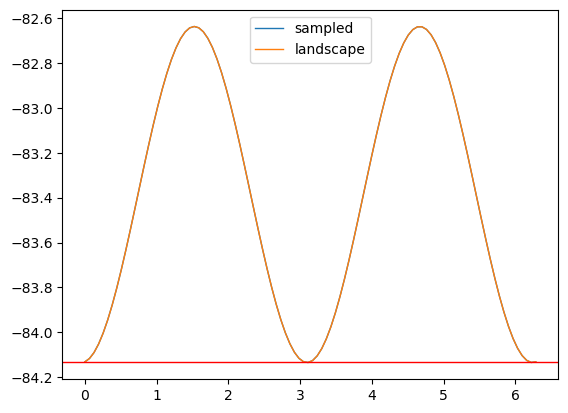

In [133]:
plt.plot(np.linspace(0, 2*np.pi, 100),test_traj, label='sampled', lw=1)
plt.plot(np.linspace(0, 2*np.pi, 100),test_traj_an, label='landscape', lw=1)
plt.legend()

theta_opt = np.linspace(0, 2*np.pi, 100)[np.argmin(test_traj)]
print(np.min(test_traj), theta_opt, hf_obj.energy_tot()-hf_obj.energy_nuc())
plt.axhline(y=hf_obj.energy_tot()-hf_obj.energy_nuc(), color='red', lw=1)